# Hyperparameter Optimization

In [1]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_addons as tfa

from sklearn.model_selection import KFold
from sklearn.metrics import precision_recall_fscore_support, roc_auc_score, accuracy_score
from tensorflow.keras.layers import Input, LSTM, Dense, Flatten, TimeDistributed, Conv1D, BatchNormalization, MaxPooling1D, Bidirectional, Concatenate
from tensorflow.keras import Model
from tensorflow.keras.initializers import Constant
from keras.layers.advanced_activations import PReLU

import sys
module_path = os.path.abspath(os.getcwd() + '\\..')
if module_path not in sys.path:
    sys.path.append(module_path)
from src.data.load_dataset import load_dataset, load_fusioned_dataset

In [2]:
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor="val_loss",
    patience=50,
    restore_best_weights=True,
)

kf = KFold(n_splits=5, shuffle=True, random_state=48)
epochs = 100
cnn_auc = []
rnn_auc = []

In [3]:
batch_sizes = [25, 32]
neurons = [64, 128, 256]

## 1. Unimodal Body Modality (Skeleton)

In [4]:
X_train, X_test, y_train, y_test = load_dataset('skeleton', binary=True)
X = X_train.copy()
y = y_train.copy()

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

n_length, n_features, n_outputs = X_train.shape[2], X_train.shape[-1], y_train.shape[1]

(812, 1, 350, 35) (812, 1)
(245, 1, 350, 35) (245, 1)


### CNN + Bidirectional LSTM

#### Activation: Tanh, Optimizer: RMSprop

In [5]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [6]:
body_best_binary_cnnlstm_acc = 0.0
body_best_binary_cnnlstm_model = None
body_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [7]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_cnnlstm_acc):
                body_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                body_best_binary_cnnlstm_model = body_binary_cnnlstm_model
                body_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 11s - loss: 0.7779 - accuracy: 0.4823 - auc: 0.4683 - precision: 0.4986 - recall: 0.5493 - f1_score: 0.6809 - val_loss: 0.6919 - val_accuracy: 0.5460 - val_auc: 0.5506 - val_precision: 0.5000 - val_recall: 0.0676 - val_f1_score: 0.6245 - 11s/epoch - 426ms/step
Epoch 2/100
26/26 - 0s - loss: 0.6975 - accuracy: 0.5085 - auc: 0.5076 - precision: 0.5247 - recall: 0.5075 - f1_score: 0.6809 - val_loss: 0.7983 - val_accuracy: 0.4540 - val_auc: 0.5254 - val_precision: 0.4540 - val_recall: 1.0000 - val_f1_score: 0.6245 - 488ms/epoch - 19ms/step
Epoch 3/100
26/26 - 0s - loss: 0.7120 - accuracy: 0.5131 - auc: 0.5193 - precision: 0.5248 - recall: 0.6000 - f1_score: 0.6809 - val_loss: 0.7634 - val_accuracy: 0.4540 - val_auc: 0.5819 - val_precision: 0.4540 - val_recall: 1.0000 - val_f1_score: 0.6245 - 481ms/epoch - 19ms/step
Epoch 4/100
26/26 - 0s - loss: 0.6944 - accuracy: 0.5208 - auc: 0.5062 - precision: 0.5249 - recall: 0.7552 - f1_score: 0.6809 

In [8]:
print(body_best_binary_cnnlstm_acc)
print(body_binary_cnnlstm_values)

0.7469135522842407
{'batch_size': 32, 'neurons': 128}


#### Activation: Tanh, Optimizer: Adam

In [10]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [9]:
body_best_binary_cnnlstm_acc = 0.0
body_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [11]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_cnnlstm_acc):
                body_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                body_best_binary_cnnlstm_model = body_binary_cnnlstm_model
                body_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 4s - loss: 0.7469 - accuracy: 0.5562 - auc_30: 0.5500 - precision_30: 0.5503 - recall_30: 0.7672 - f1_score: 0.6809 - val_loss: 0.7479 - val_accuracy: 0.4540 - val_auc_30: 0.6388 - val_precision_30: 0.4540 - val_recall_30: 1.0000 - val_f1_score: 0.6245 - 4s/epoch - 148ms/step
Epoch 2/100
26/26 - 0s - loss: 0.6873 - accuracy: 0.5562 - auc_30: 0.5622 - precision_30: 0.5577 - recall_30: 0.6776 - f1_score: 0.6809 - val_loss: 0.6797 - val_accuracy: 0.6319 - val_auc_30: 0.6603 - val_precision_30: 0.5700 - val_recall_30: 0.7703 - val_f1_score: 0.6245 - 458ms/epoch - 18ms/step
Epoch 3/100
26/26 - 0s - loss: 0.6760 - accuracy: 0.5809 - auc_30: 0.6032 - precision_30: 0.5854 - recall_30: 0.6448 - f1_score: 0.6809 - val_loss: 0.7002 - val_accuracy: 0.4785 - val_auc_30: 0.6829 - val_precision_30: 0.4654 - val_recall_30: 1.0000 - val_f1_score: 0.6245 - 409ms/epoch - 16ms/step
Epoch 4/100
26/26 - 0s - loss: 0.6742 - accuracy: 0.5809 - auc_30: 0.6096 -

In [12]:
print(body_best_binary_cnnlstm_acc)
print(body_binary_cnnlstm_values)

0.7177914381027222
{'batch_size': 25, 'neurons': 64}


#### Activation: Relu, Optimizer: RMSprop

In [13]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [14]:
body_best_binary_cnnlstm_acc = 0.0
body_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [15]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_cnnlstm_acc):
                body_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                body_best_binary_cnnlstm_model = body_binary_cnnlstm_model
                body_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 4s - loss: 48.1236 - accuracy: 0.4854 - auc_60: 0.4902 - precision_60: 0.5015 - recall_60: 0.4985 - f1_score: 0.5354 - val_loss: 44.4825 - val_accuracy: 0.4540 - val_auc_60: 0.5000 - val_precision_60: 0.4540 - val_recall_60: 1.0000 - val_f1_score: 0.6245 - 4s/epoch - 143ms/step
Epoch 2/100
26/26 - 1s - loss: 18.1784 - accuracy: 0.5008 - auc_60: 0.4963 - precision_60: 0.5154 - recall_60: 0.5493 - f1_score: 0.6373 - val_loss: 11.2031 - val_accuracy: 0.4540 - val_auc_60: 0.5199 - val_precision_60: 0.4534 - val_recall_60: 0.9865 - val_f1_score: 0.6245 - 761ms/epoch - 29ms/step
Epoch 3/100
26/26 - 1s - loss: 12.1898 - accuracy: 0.5085 - auc_60: 0.5143 - precision_60: 0.5231 - recall_60: 0.5403 - f1_score: 0.6301 - val_loss: 4.1195 - val_accuracy: 0.5767 - val_auc_60: 0.6205 - val_precision_60: 0.5203 - val_recall_60: 0.8649 - val_f1_score: 0.6186 - 770ms/epoch - 30ms/step
Epoch 4/100
26/26 - 1s - loss: 11.3314 - accuracy: 0.5069 - auc_60: 0.

In [16]:
print(body_best_binary_cnnlstm_acc)
print(body_binary_cnnlstm_values)

0.7345678806304932
{'batch_size': 25, 'neurons': 64}


#### Activation: Relu, Optimizer: Adam

In [18]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [17]:
body_best_binary_cnnlstm_acc = 0.0
body_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [19]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_cnnlstm_acc):
                body_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                body_best_binary_cnnlstm_model = body_binary_cnnlstm_model
                body_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 3s - loss: 19.0693 - accuracy: 0.5408 - auc_90: 0.5430 - precision_90: 0.5556 - recall_90: 0.5522 - f1_score: 0.6375 - val_loss: 6.6488 - val_accuracy: 0.4785 - val_auc_90: 0.5601 - val_precision_90: 0.4641 - val_recall_90: 0.9595 - val_f1_score: 0.6245 - 3s/epoch - 130ms/step
Epoch 2/100
26/26 - 1s - loss: 4.3736 - accuracy: 0.5747 - auc_90: 0.5891 - precision_90: 0.5865 - recall_90: 0.5970 - f1_score: 0.6798 - val_loss: 11.6483 - val_accuracy: 0.4540 - val_auc_90: 0.4989 - val_precision_90: 0.4540 - val_recall_90: 1.0000 - val_f1_score: 0.6245 - 601ms/epoch - 23ms/step
Epoch 3/100
26/26 - 1s - loss: 6.1576 - accuracy: 0.5131 - auc_90: 0.5310 - precision_90: 0.5274 - recall_90: 0.5463 - f1_score: 0.6757 - val_loss: 9.4251 - val_accuracy: 0.4601 - val_auc_90: 0.5169 - val_precision_90: 0.4568 - val_recall_90: 1.0000 - val_f1_score: 0.6245 - 595ms/epoch - 23ms/step
Epoch 4/100
26/26 - 1s - loss: 5.3449 - accuracy: 0.5362 - auc_90: 0.5457

In [20]:
print(body_best_binary_cnnlstm_acc)
print(body_binary_cnnlstm_values)

0.7222222089767456
{'batch_size': 25, 'neurons': 256}


#### Predictions on holdout set

In [5]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=128, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(128, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [6]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    cnnlstm_binary_body_model = CNNLSTM(n_features, n_length, n_outputs)
    history = cnnlstm_binary_body_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=32)

Epoch 1/100
21/21 - 12s - loss: 1.0391 - accuracy: 0.5054 - auc: 0.4617 - precision: 0.5126 - recall: 0.8478 - f1_score: 0.6809 - val_loss: 0.7395 - val_accuracy: 0.4540 - val_auc: 0.6447 - val_precision: 0.4540 - val_recall: 1.0000 - val_f1_score: 0.6245 - 12s/epoch - 553ms/step
Epoch 2/100
21/21 - 1s - loss: 0.6961 - accuracy: 0.5285 - auc: 0.5399 - precision: 0.5323 - recall: 0.7134 - f1_score: 0.6809 - val_loss: 0.6859 - val_accuracy: 0.5460 - val_auc: 0.6227 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - val_f1_score: 0.6245 - 739ms/epoch - 35ms/step
Epoch 3/100
21/21 - 1s - loss: 0.6932 - accuracy: 0.5424 - auc: 0.5459 - precision: 0.5516 - recall: 0.6060 - f1_score: 0.6809 - val_loss: 0.7120 - val_accuracy: 0.4540 - val_auc: 0.6482 - val_precision: 0.4534 - val_recall: 0.9865 - val_f1_score: 0.6245 - 624ms/epoch - 30ms/step
Epoch 4/100
21/21 - 1s - loss: 0.6750 - accuracy: 0.5778 - auc: 0.6036 - precision: 0.5728 - recall: 0.7164 - f1_score: 0.6809 - val_loss: 0.6573 - v

In [7]:
y_pred = cnnlstm_binary_body_model.predict(X_test)
_, acc, auc, precision, recall, f1 = cnnlstm_binary_body_model.evaluate(X_test, y_test)
cnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 66.12% 
ROC/AUC: 0.65 
Precision: 0.90 
Recall: 0.67 
F1 score: 0.91


### RCNN

#### Optimizer: RMSprop

In [7]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [8]:
body_best_binary_rcnn_acc = 0.0
body_best_binary_rcnn_model = None
body_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [9]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_rcnn_acc):
                body_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                body_best_binary_rcnn_model = body_binary_rcnn_model
                body_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 2s - loss: 0.8919 - accuracy: 0.6102 - auc_5: 0.6410 - precision_5: 0.6178 - recall_5: 0.6418 - f1_score: 0.6809 - val_loss: 8.0148 - val_accuracy: 0.4540 - val_auc_5: 0.5000 - val_precision_5: 0.4540 - val_recall_5: 1.0000 - val_f1_score: 0.6245 - 2s/epoch - 71ms/step
Epoch 2/100
26/26 - 0s - loss: 0.6587 - accuracy: 0.6687 - auc_5: 0.7175 - precision_5: 0.6786 - recall_5: 0.6806 - f1_score: 0.6809 - val_loss: 5.1791 - val_accuracy: 0.4540 - val_auc_5: 0.5250 - val_precision_5: 0.4540 - val_recall_5: 1.0000 - val_f1_score: 0.6245 - 419ms/epoch - 16ms/step
Epoch 3/100
26/26 - 0s - loss: 0.6764 - accuracy: 0.6595 - auc_5: 0.7139 - precision_5: 0.6667 - recall_5: 0.6806 - f1_score: 0.6809 - val_loss: 4.7391 - val_accuracy: 0.4540 - val_auc_5: 0.5181 - val_precision_5: 0.4540 - val_recall_5: 1.0000 - val_f1_score: 0.6245 - 437ms/epoch - 17ms/step
Epoch 4/100
26/26 - 0s - loss: 0.6580 - accuracy: 0.6487 - auc_5: 0.7164 - precision_5: 0.6588

In [10]:
print(body_best_binary_rcnn_acc)
print(body_rcnn_binary_values)

0.7222222089767456
{'batch_size': 25, 'neurons': 64}


#### Optimizer: Adam

In [11]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [12]:
body_best_binary_rcnn_acc = 0.0
body_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [13]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            body_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = body_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > body_best_binary_rcnn_acc):
                body_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                body_best_binary_rcnn_model = body_binary_rcnn_model
                body_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
26/26 - 2s - loss: 0.8634 - accuracy: 0.5963 - auc_35: 0.6191 - precision_35: 0.6144 - recall_35: 0.5851 - f1_score: 0.6809 - val_loss: 6.7849 - val_accuracy: 0.4540 - val_auc_35: 0.4989 - val_precision_35: 0.4540 - val_recall_35: 1.0000 - val_f1_score: 0.6245 - 2s/epoch - 71ms/step
Epoch 2/100
26/26 - 0s - loss: 0.6425 - accuracy: 0.6687 - auc_35: 0.7182 - precision_35: 0.6786 - recall_35: 0.6806 - f1_score: 0.6809 - val_loss: 4.1622 - val_accuracy: 0.4540 - val_auc_35: 0.5394 - val_precision_35: 0.4540 - val_recall_35: 1.0000 - val_f1_score: 0.6245 - 343ms/epoch - 13ms/step
Epoch 3/100
26/26 - 0s - loss: 0.5962 - accuracy: 0.6980 - auc_35: 0.7539 - precision_35: 0.7062 - recall_35: 0.7104 - f1_score: 0.6809 - val_loss: 1.2209 - val_accuracy: 0.5644 - val_auc_35: 0.6296 - val_precision_35: 0.5133 - val_recall_35: 0.7838 - val_f1_score: 0.6245 - 341ms/epoch - 13ms/step
Epoch 4/100
26/26 - 0s - loss: 0.5644 - accuracy: 0.7134 - auc_35: 0.7808 - 

In [15]:
print(body_best_binary_rcnn_acc)
print(body_rcnn_binary_values)

0.7407407164573669
{'batch_size': 25, 'neurons': 128}


#### Predictions on the holdout set

In [16]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=128, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(128, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [17]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    rcnn_binary_body_model = RCNN(n_features, n_length, n_outputs)
    history = rcnn_binary_body_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=25)

Epoch 1/100
26/26 - 2s - loss: 1.0561 - accuracy: 0.6271 - auc_65: 0.6252 - precision_65: 0.6388 - recall_65: 0.6388 - f1_score: 0.6809 - val_loss: 9.1484 - val_accuracy: 0.4540 - val_auc_65: 0.5000 - val_precision_65: 0.4540 - val_recall_65: 1.0000 - val_f1_score: 0.6245 - 2s/epoch - 66ms/step
Epoch 2/100
26/26 - 0s - loss: 0.6983 - accuracy: 0.6394 - auc_65: 0.6953 - precision_65: 0.6369 - recall_65: 0.7015 - f1_score: 0.6809 - val_loss: 2.0910 - val_accuracy: 0.4908 - val_auc_65: 0.6728 - val_precision_65: 0.4710 - val_recall_65: 0.9865 - val_f1_score: 0.6245 - 375ms/epoch - 14ms/step
Epoch 3/100
26/26 - 0s - loss: 0.6635 - accuracy: 0.6410 - auc_65: 0.7179 - precision_65: 0.6700 - recall_65: 0.6000 - f1_score: 0.6809 - val_loss: 0.8541 - val_accuracy: 0.6012 - val_auc_65: 0.6555 - val_precision_65: 0.5529 - val_recall_65: 0.6351 - val_f1_score: 0.6245 - 377ms/epoch - 15ms/step
Epoch 4/100
26/26 - 0s - loss: 0.5701 - accuracy: 0.6995 - auc_65: 0.7750 - precision_65: 0.7071 - recall_

In [45]:
y_pred = rcnn_binary_body_model.predict(X_test)
_, acc, auc, precision, recall, f1 = rcnn_binary_body_model.evaluate(X_test, y_test)
rnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

ValueError: in user code:

    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\engine\training.py", line 1801, in predict_function  *
        return step_function(self, iterator)
    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\engine\training.py", line 1790, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\engine\training.py", line 1783, in run_step  **
        outputs = model.predict_step(data)
    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\engine\training.py", line 1751, in predict_step
        return self(x, training=False)
    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\utils\traceback_utils.py", line 67, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "c:\Users\angel\.virtualenvs\masters-thesis-47ATZEh-\lib\site-packages\keras\engine\input_spec.py", line 264, in assert_input_compatibility
        raise ValueError(f'Input {input_index} of layer "{layer_name}" is '

    ValueError: Input 0 of layer "model_69" is incompatible with the layer: expected shape=(None, 1, 350, 35), found shape=(None, 1, 350, 25)


## 2. Unimodal Face modality (Action units + Head pose)

In [24]:
X_train, X_test, y_train, y_test = load_dataset('AUs', binary=True)
X = X_train.copy()
y = y_train.copy()

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

n_length, n_features, n_outputs = X_train.shape[2], X_train.shape[-1], y_train.shape[1]

(782, 1, 350, 25) (782, 1)
(238, 1, 350, 25) (238, 1)


### CNN + Bidirectional LSTM

#### Activation: tanh, Optimizer: RMSprop

In [5]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [6]:
face_best_binary_cnnlstm_acc = 0.0
face_best_binary_cnnlstm_model = None
face_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [7]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_cnnlstm_acc):
                face_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                face_best_binary_cnnlstm_model = face_binary_cnnlstm_model
                face_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 15s - loss: 0.7473 - accuracy: 0.5536 - auc: 0.5475 - precision: 0.5609 - recall: 0.6149 - f1_score: 0.6800 - val_loss: 0.6654 - val_accuracy: 0.5987 - val_auc: 0.6553 - val_precision: 0.5556 - val_recall: 0.6849 - val_f1_score: 0.6348 - 15s/epoch - 594ms/step
Epoch 2/100
25/25 - 0s - loss: 0.6761 - accuracy: 0.5920 - auc: 0.6099 - precision: 0.6018 - recall: 0.6149 - f1_score: 0.6800 - val_loss: 0.6934 - val_accuracy: 0.6115 - val_auc: 0.6679 - val_precision: 0.5517 - val_recall: 0.8767 - val_f1_score: 0.6348 - 472ms/epoch - 19ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6842 - accuracy: 0.5840 - auc: 0.6021 - precision: 0.5886 - recall: 0.6398 - f1_score: 0.6800 - val_loss: 0.6605 - val_accuracy: 0.6051 - val_auc: 0.6601 - val_precision: 0.6122 - val_recall: 0.4110 - val_f1_score: 0.6348 - 532ms/epoch - 21ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6723 - accuracy: 0.6048 - auc: 0.6147 - precision: 0.6022 - recall: 0.6863 - f1_score: 0.6800 

In [8]:
print(face_best_binary_cnnlstm_acc)
print(face_binary_cnnlstm_values)

0.7051281929016113
{'batch_size': 32, 'neurons': 128}


#### Activation: tanh, Optimizer: Adam

In [9]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [10]:
face_best_binary_cnnlstm_acc = 0.0
face_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [11]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_cnnlstm_acc):
                face_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                face_best_binary_cnnlstm_model = face_binary_cnnlstm_model
                face_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.8470 - accuracy: 0.5232 - auc_30: 0.5170 - precision_30: 0.5300 - recall_30: 0.6584 - f1_score: 0.6800 - val_loss: 0.6848 - val_accuracy: 0.5924 - val_auc_30: 0.5904 - val_precision_30: 0.5421 - val_recall_30: 0.7945 - val_f1_score: 0.6348 - 4s/epoch - 141ms/step
Epoch 2/100
25/25 - 0s - loss: 0.6796 - accuracy: 0.5792 - auc_30: 0.5893 - precision_30: 0.5643 - recall_30: 0.8043 - f1_score: 0.6800 - val_loss: 0.6742 - val_accuracy: 0.5605 - val_auc_30: 0.6133 - val_precision_30: 0.5204 - val_recall_30: 0.6986 - val_f1_score: 0.6348 - 427ms/epoch - 17ms/step
Epoch 3/100
25/25 - 0s - loss: 0.6692 - accuracy: 0.6112 - auc_30: 0.6255 - precision_30: 0.5925 - recall_30: 0.7857 - f1_score: 0.6800 - val_loss: 0.6710 - val_accuracy: 0.5987 - val_auc_30: 0.6309 - val_precision_30: 0.5455 - val_recall_30: 0.8219 - val_f1_score: 0.6348 - 424ms/epoch - 17ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6688 - accuracy: 0.6048 - auc_30: 0.6192 -

In [12]:
print(face_best_binary_cnnlstm_acc)
print(face_binary_cnnlstm_values)

0.7388535141944885
{'batch_size': 32, 'neurons': 64}


#### Activation: relu, Optimizer: RMSprop

In [13]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [14]:
face_best_binary_cnnlstm_acc = 0.0
face_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [15]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_cnnlstm_acc):
                face_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                face_best_binary_cnnlstm_model = face_binary_cnnlstm_model
                face_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 3s - loss: 22887.4688 - accuracy: 0.4864 - auc_60: 0.4846 - precision_60: 0.5014 - recall_60: 0.5373 - f1_score: 0.5460 - val_loss: 36645.4961 - val_accuracy: 0.4650 - val_auc_60: 0.4973 - val_precision_60: 0.4636 - val_recall_60: 0.9589 - val_f1_score: 0.6250 - 3s/epoch - 113ms/step
Epoch 2/100
25/25 - 1s - loss: 35232.0586 - accuracy: 0.4880 - auc_60: 0.4836 - precision_60: 0.5027 - recall_60: 0.5839 - f1_score: 0.5908 - val_loss: 1126.8865 - val_accuracy: 0.4713 - val_auc_60: 0.5060 - val_precision_60: 0.4679 - val_recall_60: 1.0000 - val_f1_score: 0.6376 - 556ms/epoch - 22ms/step
Epoch 3/100
25/25 - 1s - loss: 24915.2812 - accuracy: 0.5488 - auc_60: 0.5529 - precision_60: 0.5806 - recall_60: 0.4472 - f1_score: 0.6055 - val_loss: 1846.0988 - val_accuracy: 0.5860 - val_auc_60: 0.6294 - val_precision_60: 0.5417 - val_recall_60: 0.7123 - val_f1_score: 0.6344 - 502ms/epoch - 20ms/step
Epoch 4/100
25/25 - 1s - loss: 2956.2495 - accuracy: 

In [16]:
print(face_best_binary_cnnlstm_acc)
print(face_binary_cnnlstm_values)

0.6433120965957642
{'batch_size': 25, 'neurons': 64}


#### Activation: relu, Optimizer: Adam

In [17]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [18]:
face_best_binary_cnnlstm_acc = 0.0
face_binary_cnnlstm_values = { 'batch_size': 0, 'neurons': 0 }

In [19]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_cnnlstm_acc):
                face_best_binary_cnnlstm_acc = history.history['val_accuracy'][-1]
                face_best_binary_cnnlstm_model = face_binary_cnnlstm_model
                face_binary_cnnlstm_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 3s - loss: 19555.1914 - accuracy: 0.5216 - auc_90: 0.5304 - precision_90: 0.5363 - recall_90: 0.5280 - f1_score: 0.5967 - val_loss: 8458.2061 - val_accuracy: 0.5796 - val_auc_90: 0.5784 - val_precision_90: 0.5593 - val_recall_90: 0.4521 - val_f1_score: 0.6277 - 3s/epoch - 101ms/step
Epoch 2/100
25/25 - 0s - loss: 4433.5005 - accuracy: 0.5296 - auc_90: 0.5202 - precision_90: 0.5348 - recall_90: 0.6677 - f1_score: 0.6202 - val_loss: 11352.9199 - val_accuracy: 0.4968 - val_auc_90: 0.5315 - val_precision_90: 0.4792 - val_recall_90: 0.9452 - val_f1_score: 0.6311 - 399ms/epoch - 16ms/step
Epoch 3/100
25/25 - 0s - loss: 23849.4824 - accuracy: 0.5344 - auc_90: 0.5333 - precision_90: 0.5671 - recall_90: 0.4068 - f1_score: 0.5416 - val_loss: 137.1291 - val_accuracy: 0.4777 - val_auc_90: 0.5119 - val_precision_90: 0.4710 - val_recall_90: 1.0000 - val_f1_score: 0.6404 - 455ms/epoch - 18ms/step
Epoch 4/100
25/25 - 0s - loss: 6676.9805 - accuracy: 0.

In [20]:
print(face_best_binary_cnnlstm_acc)
print(face_binary_cnnlstm_values)

0.662420392036438
{'batch_size': 25, 'neurons': 128}


#### Predictions on holdout set

In [37]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=64, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(64, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [38]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    cnnlstm_binary_face_model = CNNLSTM(n_features, n_length, n_outputs)
    history = cnnlstm_binary_face_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=32)

Epoch 1/100
20/20 - 4s - loss: 0.8100 - accuracy: 0.5296 - auc_135: 0.5335 - precision_135: 0.5361 - recall_135: 0.6460 - f1_score: 0.6800 - val_loss: 0.6908 - val_accuracy: 0.5541 - val_auc_135: 0.6323 - val_precision_135: 0.5124 - val_recall_135: 0.8493 - val_f1_score: 0.6348 - 4s/epoch - 199ms/step
Epoch 2/100
20/20 - 0s - loss: 0.6769 - accuracy: 0.5888 - auc_135: 0.6004 - precision_135: 0.5791 - recall_135: 0.7391 - f1_score: 0.6800 - val_loss: 0.6686 - val_accuracy: 0.5987 - val_auc_135: 0.6625 - val_precision_135: 0.5500 - val_recall_135: 0.7534 - val_f1_score: 0.6348 - 407ms/epoch - 20ms/step
Epoch 3/100
20/20 - 0s - loss: 0.6720 - accuracy: 0.5904 - auc_135: 0.6217 - precision_135: 0.5825 - recall_135: 0.7236 - f1_score: 0.6800 - val_loss: 0.6656 - val_accuracy: 0.6115 - val_auc_135: 0.6698 - val_precision_135: 0.5577 - val_recall_135: 0.7945 - val_f1_score: 0.6348 - 417ms/epoch - 21ms/step
Epoch 4/100
20/20 - 0s - loss: 0.6695 - accuracy: 0.6032 - auc_135: 0.6214 - precision_

In [46]:
y_pred = cnnlstm_binary_face_model.predict(X_test)
_, acc, auc, precision, recall, f1 = cnnlstm_binary_face_model.evaluate(X_test, y_test)
cnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 60.08% 
ROC/AUC: 0.68 
Precision: 0.90 
Recall: 0.60 
F1 score: 0.92


### RCNN

#### Optimizer: RMSprop

In [25]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [26]:
face_best_binary_rcnn_acc = 0.0
face_best_binary_rcnn_model = None
face_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [27]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_rcnn_acc):
                face_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                face_best_binary_rcnn_model = face_binary_rcnn_model
                face_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 2s - loss: 1.1078 - accuracy: 0.5200 - auc_70: 0.5289 - precision_70: 0.5362 - recall_70: 0.5062 - f1_score: 0.6800 - val_loss: 0.7914 - val_accuracy: 0.4713 - val_auc_70: 0.5211 - val_precision_70: 0.4679 - val_recall_70: 1.0000 - val_f1_score: 0.6348 - 2s/epoch - 69ms/step
Epoch 2/100
25/25 - 0s - loss: 0.7962 - accuracy: 0.5536 - auc_70: 0.5934 - precision_70: 0.5494 - recall_70: 0.7422 - f1_score: 0.6800 - val_loss: 1.2659 - val_accuracy: 0.4650 - val_auc_70: 0.4986 - val_precision_70: 0.4641 - val_recall_70: 0.9726 - val_f1_score: 0.6228 - 384ms/epoch - 15ms/step
Epoch 3/100
25/25 - 0s - loss: 0.8380 - accuracy: 0.5552 - auc_70: 0.5938 - precision_70: 0.5667 - recall_70: 0.5807 - f1_score: 0.6800 - val_loss: 0.7184 - val_accuracy: 0.4713 - val_auc_70: 0.5135 - val_precision_70: 0.4679 - val_recall_70: 1.0000 - val_f1_score: 0.6348 - 364ms/epoch - 15ms/step
Epoch 4/100
25/25 - 0s - loss: 0.7946 - accuracy: 0.5520 - auc_70: 0.5560 - 

In [33]:
print(face_best_binary_rcnn_acc)
print(face_rcnn_binary_values)

0.5705128312110901
{'batch_size': 25, 'neurons': 256}


#### Optimizer: Adam

In [29]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [30]:
face_best_binary_rcnn_acc = 0.0
face_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [31]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            face_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = face_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > face_best_binary_rcnn_acc):
                face_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                face_best_binary_rcnn_model = face_binary_rcnn_model
                face_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 1s - loss: 1.0793 - accuracy: 0.5344 - auc_100: 0.5086 - precision_100: 0.5318 - recall_100: 0.8043 - f1_score: 0.6800 - val_loss: 0.6916 - val_accuracy: 0.5096 - val_auc_100: 0.5175 - val_precision_100: 0.4846 - val_recall_100: 0.8630 - val_f1_score: 0.6348 - 1s/epoch - 55ms/step
Epoch 2/100
25/25 - 0s - loss: 0.8222 - accuracy: 0.5536 - auc_100: 0.5789 - precision_100: 0.5526 - recall_100: 0.7019 - f1_score: 0.6800 - val_loss: 0.7217 - val_accuracy: 0.4713 - val_auc_100: 0.5241 - val_precision_100: 0.4679 - val_recall_100: 1.0000 - val_f1_score: 0.6348 - 288ms/epoch - 12ms/step
Epoch 3/100
25/25 - 0s - loss: 0.6919 - accuracy: 0.5968 - auc_100: 0.6222 - precision_100: 0.6190 - recall_100: 0.5652 - f1_score: 0.6800 - val_loss: 0.7291 - val_accuracy: 0.4713 - val_auc_100: 0.5117 - val_precision_100: 0.4675 - val_recall_100: 0.9863 - val_f1_score: 0.6348 - 302ms/epoch - 12ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6740 - accuracy: 0.6000 -

In [34]:
print(face_best_binary_rcnn_acc)
print(face_rcnn_binary_values)

0.5705128312110901
{'batch_size': 25, 'neurons': 256}


#### Predictions on holdout set

In [35]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=256, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(256, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [36]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    rcnn_binary_face_model = RCNN(n_features, n_length, n_outputs)
    history = rcnn_binary_face_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=25)

Epoch 1/100
25/25 - 2s - loss: 2.2521 - accuracy: 0.4976 - auc_130: 0.5030 - precision_130: 0.5115 - recall_130: 0.5528 - f1_score: 0.6787 - val_loss: 3.2117 - val_accuracy: 0.4650 - val_auc_130: 0.5323 - val_precision_130: 0.4641 - val_recall_130: 0.9726 - val_f1_score: 0.6256 - 2s/epoch - 66ms/step
Epoch 2/100
25/25 - 0s - loss: 1.2762 - accuracy: 0.5568 - auc_130: 0.5958 - precision_130: 0.5882 - recall_130: 0.4658 - f1_score: 0.6822 - val_loss: 0.9718 - val_accuracy: 0.5796 - val_auc_130: 0.5476 - val_precision_130: 0.5614 - val_recall_130: 0.4384 - val_f1_score: 0.6348 - 404ms/epoch - 16ms/step
Epoch 3/100
25/25 - 0s - loss: 1.3051 - accuracy: 0.5456 - auc_130: 0.5729 - precision_130: 0.5586 - recall_130: 0.5621 - f1_score: 0.6808 - val_loss: 0.9181 - val_accuracy: 0.5350 - val_auc_130: 0.4715 - val_precision_130: 0.0000e+00 - val_recall_130: 0.0000e+00 - val_f1_score: 0.6376 - 400ms/epoch - 16ms/step
Epoch 4/100
25/25 - 0s - loss: 0.8838 - accuracy: 0.5840 - auc_130: 0.6377 - pre

In [47]:
y_pred = rcnn_binary_face_model.predict(X_test)
_, acc, auc, precision, recall, f1 = rcnn_binary_face_model.evaluate(X_test, y_test)
rnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 17.65% 
ROC/AUC: 0.51 
Precision: 1.00 
Recall: 0.03 
F1 score: 0.92


## 3. Multimodal Early Fusion

In [21]:
X_train, X_test, y_train, y_test = load_fusioned_dataset(binary=True)
X = X_train.copy()
y = y_train.copy()

print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

n_length, n_features, n_outputs = X_train.shape[2], X_train.shape[-1], y_train.shape[1]

(782, 1, 350, 60) (782, 1)
(238, 1, 350, 60) (238, 1)


### CNN + BiLSTM

#### Activation: tanh, Optimizer: RMSprop

In [23]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [22]:
early_best_cnn_acc = 0.0
early_best_cnn_model = None
early_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [24]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_cnn_acc):
                early_best_cnn_acc = history.history['val_accuracy'][-1]
                early_best_cnn_model = early_binary_cnnlstm_model
                early_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.8980 - accuracy: 0.5120 - auc_22: 0.4897 - precision_22: 0.5184 - recall_22: 0.7453 - f1_score: 0.6800 - val_loss: 0.7123 - val_accuracy: 0.4650 - val_auc_22: 0.6281 - val_precision_22: 0.4650 - val_recall_22: 1.0000 - val_f1_score: 0.6348 - 4s/epoch - 149ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6919 - accuracy: 0.5408 - auc_22: 0.5660 - precision_22: 0.5477 - recall_22: 0.6242 - f1_score: 0.6800 - val_loss: 0.7034 - val_accuracy: 0.5287 - val_auc_22: 0.6387 - val_precision_22: 0.4965 - val_recall_22: 0.9726 - val_f1_score: 0.6348 - 551ms/epoch - 22ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6756 - accuracy: 0.5664 - auc_22: 0.6040 - precision_22: 0.5714 - recall_22: 0.6335 - f1_score: 0.6800 - val_loss: 0.6715 - val_accuracy: 0.5796 - val_auc_22: 0.6450 - val_precision_22: 0.6129 - val_recall_22: 0.2603 - val_f1_score: 0.6348 - 544ms/epoch - 22ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6756 - accuracy: 0.6016 - auc_22: 0.6195 -

In [25]:
print(early_best_cnn_acc)
print(early_cnn_values)

0.7961783409118652
{'batch_size': 25, 'neurons': 128}


#### Activation: tanh, Optimizer: Adam

In [26]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='tanh'))(flatten)
        dense = Dense(neurons, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [27]:
early_best_cnn_acc = 0.0
early_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [28]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_cnn_acc):
                early_best_cnn_acc = history.history['val_accuracy'][-1]
                early_best_cnn_model = early_binary_cnnlstm_model
                early_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 3s - loss: 0.8058 - accuracy: 0.5072 - auc_52: 0.5042 - precision_52: 0.5188 - recall_52: 0.5994 - f1_score: 0.6800 - val_loss: 0.6762 - val_accuracy: 0.5860 - val_auc_52: 0.6222 - val_precision_52: 0.5556 - val_recall_52: 0.5479 - val_f1_score: 0.6348 - 3s/epoch - 136ms/step
Epoch 2/100
25/25 - 0s - loss: 0.6603 - accuracy: 0.6224 - auc_52: 0.6462 - precision_52: 0.6503 - recall_52: 0.5776 - f1_score: 0.6800 - val_loss: 0.6805 - val_accuracy: 0.6115 - val_auc_52: 0.6371 - val_precision_52: 0.5577 - val_recall_52: 0.7945 - val_f1_score: 0.6348 - 383ms/epoch - 15ms/step
Epoch 3/100
25/25 - 0s - loss: 0.6460 - accuracy: 0.6336 - auc_52: 0.6757 - precision_52: 0.6281 - recall_52: 0.7081 - f1_score: 0.6800 - val_loss: 0.6516 - val_accuracy: 0.5924 - val_auc_52: 0.6792 - val_precision_52: 0.5517 - val_recall_52: 0.6575 - val_f1_score: 0.6348 - 435ms/epoch - 17ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6400 - accuracy: 0.6496 - auc_52: 0.6876 -

In [29]:
print(early_best_cnn_acc)
print(early_cnn_values)

0.7770700454711914
{'batch_size': 32, 'neurons': 64}


#### Activation: relu, Optimizer: RMSprop

In [30]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [31]:
early_best_cnn_acc = 0.0
early_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [32]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_cnn_acc):
                early_best_cnn_acc = history.history['val_accuracy'][-1]
                early_best_cnn_model = early_binary_cnnlstm_model
                early_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 3s - loss: 16263.8525 - accuracy: 0.4800 - auc_82: 0.4776 - precision_82: 0.4959 - recall_82: 0.5652 - f1_score: 0.5684 - val_loss: 14643.9043 - val_accuracy: 0.4968 - val_auc_82: 0.5027 - val_precision_82: 0.4516 - val_recall_82: 0.3836 - val_f1_score: 0.6161 - 3s/epoch - 129ms/step
Epoch 2/100
25/25 - 0s - loss: 14029.6592 - accuracy: 0.4976 - auc_82: 0.4937 - precision_82: 0.5132 - recall_82: 0.4845 - f1_score: 0.6168 - val_loss: 47495.7656 - val_accuracy: 0.5478 - val_auc_82: 0.4995 - val_precision_82: 0.6667 - val_recall_82: 0.0548 - val_f1_score: 0.4160 - 498ms/epoch - 20ms/step
Epoch 3/100
25/25 - 1s - loss: 19100.0371 - accuracy: 0.5152 - auc_82: 0.5098 - precision_82: 0.5279 - recall_82: 0.5590 - f1_score: 0.6077 - val_loss: 4585.7935 - val_accuracy: 0.4331 - val_auc_82: 0.4509 - val_precision_82: 0.4394 - val_recall_82: 0.7945 - val_f1_score: 0.6432 - 550ms/epoch - 22ms/step
Epoch 4/100
25/25 - 0s - loss: 4605.2920 - accuracy:

In [33]:
print(early_best_cnn_acc)
print(early_cnn_values)

0.7898089289665222
{'batch_size': 25, 'neurons': 256}


#### Activation: relu, Optimizer: Adam

In [34]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(300, activation='relu'))(flatten)
        dense = Dense(neurons, activation='relu')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [35]:
early_best_cnn_acc = 0.0
early_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [36]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_cnnlstm_model = CNNLSTM(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_cnnlstm_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_cnn_acc):
                early_best_cnn_acc = history.history['val_accuracy'][-1]
                early_best_cnn_model = early_binary_cnnlstm_model
                early_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 3s - loss: 14173.7070 - accuracy: 0.4704 - auc_112: 0.4678 - precision_112: 0.4888 - recall_112: 0.6087 - f1_score: 0.5773 - val_loss: 5.1065 - val_accuracy: 0.5605 - val_auc_112: 0.5669 - val_precision_112: 0.5286 - val_recall_112: 0.5068 - val_f1_score: 0.6306 - 3s/epoch - 105ms/step
Epoch 2/100
25/25 - 0s - loss: 11523.0156 - accuracy: 0.5008 - auc_112: 0.4981 - precision_112: 0.5167 - recall_112: 0.4814 - f1_score: 0.5331 - val_loss: 4409.1636 - val_accuracy: 0.4713 - val_auc_112: 0.5060 - val_precision_112: 0.4679 - val_recall_112: 1.0000 - val_f1_score: 0.6376 - 437ms/epoch - 17ms/step
Epoch 3/100
25/25 - 0s - loss: 15432.4268 - accuracy: 0.5248 - auc_112: 0.5099 - precision_112: 0.5202 - recall_112: 1.0000 - f1_score: 0.6844 - val_loss: 102.3151 - val_accuracy: 0.4777 - val_auc_112: 0.5119 - val_precision_112: 0.4710 - val_recall_112: 1.0000 - val_f1_score: 0.6404 - 435ms/epoch - 17ms/step
Epoch 4/100
25/25 - 0s - loss: 8320.0527

In [37]:
print(early_best_cnn_acc)
print(early_cnn_values)

0.7388535141944885
{'batch_size': 25, 'neurons': 256}


#### Predictions on holdout set

In [38]:
class CNNLSTM():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=128, kernel_size=3, activation='tanh'))(input)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(conv1d)
        flatten = TimeDistributed(Flatten())(maxpool)
        lstm = Bidirectional(LSTM(128, activation='tanh'))(flatten)
        dense = Dense(128, activation='tanh')(lstm)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [39]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    model = CNNLSTM(n_features, n_length, n_outputs)
    history = model.train(X_train, y_train, X_val, y_val, epochs, 25)

Epoch 1/100
25/25 - 4s - loss: 0.9461 - accuracy: 0.5184 - auc_142: 0.5150 - precision_142: 0.5224 - recall_142: 0.7609 - f1_score: 0.6800 - val_loss: 0.7115 - val_accuracy: 0.4650 - val_auc_142: 0.6382 - val_precision_142: 0.4650 - val_recall_142: 1.0000 - val_f1_score: 0.6348 - 4s/epoch - 140ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6886 - accuracy: 0.5328 - auc_142: 0.5538 - precision_142: 0.5421 - recall_142: 0.5994 - f1_score: 0.6800 - val_loss: 0.6990 - val_accuracy: 0.4650 - val_auc_142: 0.6437 - val_precision_142: 0.4650 - val_recall_142: 1.0000 - val_f1_score: 0.6348 - 504ms/epoch - 20ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6717 - accuracy: 0.5856 - auc_142: 0.6249 - precision_142: 0.5789 - recall_142: 0.7174 - f1_score: 0.6800 - val_loss: 0.6688 - val_accuracy: 0.5796 - val_auc_142: 0.6213 - val_precision_142: 0.5593 - val_recall_142: 0.4521 - val_f1_score: 0.6348 - 512ms/epoch - 20ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6636 - accuracy: 0.6144 - auc_142: 0.6421 - precision_

In [40]:
y_pred = model.predict(X_test)
_, acc, auc, precision, recall, f1 = model.evaluate(X_test, y_test)
cnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 50.42% 
ROC/AUC: 0.63 
Precision: 0.93 
Recall: 0.45 
F1 score: 0.92


### RCNN

#### Optimizer: RMSprop

In [41]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [42]:
early_best_binary_rcnn_acc = 0.0
early_best_binary_rcnn_model = None
early_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [44]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_binary_rcnn_acc):
                early_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                early_best_binary_rcnn_model = early_binary_rcnn_model
                early_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 2s - loss: 1.0381 - accuracy: 0.5248 - auc_147: 0.5401 - precision_147: 0.5494 - recall_147: 0.4317 - f1_score: 0.6800 - val_loss: 0.9154 - val_accuracy: 0.4650 - val_auc_147: 0.4934 - val_precision_147: 0.4650 - val_recall_147: 1.0000 - val_f1_score: 0.6348 - 2s/epoch - 66ms/step
Epoch 2/100
25/25 - 0s - loss: 0.7678 - accuracy: 0.5568 - auc_147: 0.5835 - precision_147: 0.5692 - recall_147: 0.5745 - f1_score: 0.6800 - val_loss: 0.7188 - val_accuracy: 0.4650 - val_auc_147: 0.5904 - val_precision_147: 0.4650 - val_recall_147: 1.0000 - val_f1_score: 0.6348 - 322ms/epoch - 13ms/step
Epoch 3/100
25/25 - 0s - loss: 0.7392 - accuracy: 0.5632 - auc_147: 0.6017 - precision_147: 0.5614 - recall_147: 0.6957 - f1_score: 0.6800 - val_loss: 0.7445 - val_accuracy: 0.4650 - val_auc_147: 0.5020 - val_precision_147: 0.4650 - val_recall_147: 1.0000 - val_f1_score: 0.6348 - 315ms/epoch - 13ms/step
Epoch 4/100
25/25 - 0s - loss: 0.7504 - accuracy: 0.5888 -

In [45]:
print(early_best_binary_rcnn_acc)
print(early_rcnn_binary_values)

0.6942675113677979
{'batch_size': 32, 'neurons': 128}


#### Optimizer: Adam

In [46]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs, neurons):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(neurons, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [47]:
early_best_binary_rcnn_acc = 0.0
early_rcnn_binary_values = { 'batch_size': 0, 'neurons': 0 }

In [48]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            X_train, X_val = X[train_index], X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            early_binary_rcnn_model = RCNN(n_features, n_length, n_outputs, neurons=n)
            history = early_binary_rcnn_model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > early_best_binary_rcnn_acc):
                early_best_binary_rcnn_acc = history.history['val_accuracy'][-1]
                early_best_binary_rcnn_model = early_binary_rcnn_model
                early_rcnn_binary_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 2s - loss: 1.0274 - accuracy: 0.5184 - auc_177: 0.5175 - precision_177: 0.5254 - recall_177: 0.6739 - f1_score: 0.6800 - val_loss: 0.7528 - val_accuracy: 0.4713 - val_auc_177: 0.5340 - val_precision_177: 0.4679 - val_recall_177: 1.0000 - val_f1_score: 0.6348 - 2s/epoch - 78ms/step
Epoch 2/100
25/25 - 0s - loss: 0.8563 - accuracy: 0.5536 - auc_177: 0.5773 - precision_177: 0.5630 - recall_177: 0.5963 - f1_score: 0.6800 - val_loss: 0.6833 - val_accuracy: 0.4713 - val_auc_177: 0.6248 - val_precision_177: 0.4679 - val_recall_177: 1.0000 - val_f1_score: 0.6348 - 265ms/epoch - 11ms/step
Epoch 3/100
25/25 - 0s - loss: 0.7161 - accuracy: 0.5744 - auc_177: 0.6153 - precision_177: 0.5733 - recall_177: 0.6801 - f1_score: 0.6800 - val_loss: 0.6781 - val_accuracy: 0.4777 - val_auc_177: 0.5253 - val_precision_177: 0.4710 - val_recall_177: 1.0000 - val_f1_score: 0.6348 - 271ms/epoch - 11ms/step
Epoch 4/100
25/25 - 0s - loss: 0.7115 - accuracy: 0.5664 -

In [49]:
print(early_best_binary_rcnn_acc)
print(early_rcnn_binary_values)

0.6153846383094788
{'batch_size': 25, 'neurons': 128}


#### Predictions on holdout set

In [50]:
class RCNN():
    def __init__(self, n_features, n_length, n_outputs):
        input = Input(shape=(1, n_length, n_features))
        conv1d = TimeDistributed(Conv1D(filters=128, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input)
        bn = TimeDistributed(BatchNormalization())(conv1d)
        maxpool = TimeDistributed(MaxPooling1D(pool_size=2, strides=2, data_format='channels_first'))(bn)
        flatten = Flatten()(maxpool)
        dense = Dense(128, activation=PReLU(alpha_initializer=Constant(value=0.25)))(flatten)
        output = Dense(units=n_outputs, activation='sigmoid')(dense)
        model = Model(inputs=input, outputs=output)
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, X_train, y_train, X_val, y_val, epochs, batch_size):
        history = self.model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, X_test, y_test):
        results = self.model.evaluate(X_test, y_test, verbose=0)
        return results

    def predict(self, X_test):
        predictions = self.model.predict(X_test)
        return predictions

In [51]:
for train_index, val_index in kf.split(X):
    X_train, X_val = X[train_index], X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    model = RCNN(n_features, n_length, n_outputs)
    history = model.train(X_train, y_train, X_val, y_val, epochs=epochs, batch_size=32)

Epoch 1/100
20/20 - 2s - loss: 2.1131 - accuracy: 0.4912 - auc_207: 0.4793 - precision_207: 0.5063 - recall_207: 0.4969 - f1_score: 0.6759 - val_loss: 0.7833 - val_accuracy: 0.5732 - val_auc_207: 0.5192 - val_precision_207: 0.5288 - val_recall_207: 0.7534 - val_f1_score: 0.6376 - 2s/epoch - 88ms/step
Epoch 2/100
20/20 - 0s - loss: 0.9685 - accuracy: 0.5440 - auc_207: 0.5578 - precision_207: 0.5478 - recall_207: 0.6584 - f1_score: 0.6800 - val_loss: 0.8565 - val_accuracy: 0.4713 - val_auc_207: 0.5242 - val_precision_207: 0.4675 - val_recall_207: 0.9863 - val_f1_score: 0.6348 - 282ms/epoch - 14ms/step
Epoch 3/100
20/20 - 0s - loss: 1.0967 - accuracy: 0.5200 - auc_207: 0.5267 - precision_207: 0.5297 - recall_207: 0.6087 - f1_score: 0.6808 - val_loss: 0.8677 - val_accuracy: 0.4650 - val_auc_207: 0.5369 - val_precision_207: 0.4645 - val_recall_207: 0.9863 - val_f1_score: 0.6348 - 280ms/epoch - 14ms/step
Epoch 4/100
20/20 - 0s - loss: 1.1445 - accuracy: 0.5168 - auc_207: 0.5399 - precision_2

In [52]:
y_pred = model.predict(X_test)
_, acc, auc, precision, recall, f1 = model.evaluate(X_test, y_test)
rnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 28.15% 
ROC/AUC: 0.50 
Precision: 0.94 
Recall: 0.16 
F1 score: 0.92


## 4. Multimodal Late Fusion

In [20]:
body_X_train, body_X_test, body_y_train, body_y_test = load_dataset('skeleton', binary=True, fusion=True)
body_X = body_X_train.copy()
body_y = body_y_train.copy()

print(body_X_train.shape, body_y_train.shape)
print(body_X_test.shape, body_y_test.shape)

(782, 1, 350, 35) (782, 1)
(238, 1, 350, 35) (238, 1)


In [21]:
face_X_train, face_X_test, face_y_train, face_y_test = load_dataset('AUs', binary=True)
face_X = face_X_train.copy()
face_y = face_y_train.copy()

print(face_X_train.shape, face_y_train.shape)
print(face_X_test.shape, face_y_test.shape)

(782, 1, 350, 25) (782, 1)
(238, 1, 350, 25) (238, 1)


In [55]:
n_length, body_features, face_features, n_outputs = face_X_train.shape[2], body_X_train.shape[-1], face_X_train.shape[-1], body_y_train.shape[1]

### CNN + Bidirectional LSTM

#### Activation: tanh, Optimizer: RMSprop

In [56]:
class fusioned_CNNLSTM():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_1)
        flatten_1 = TimeDistributed(Flatten())(maxpool_1)
        lstm_1 = LSTM(300)(flatten_1)
        dense_1 = Dense(neurons, activation='tanh')(lstm_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_2)
        flatten_2 = TimeDistributed(Flatten())(maxpool_2)
        lstm_2 = LSTM(300)(flatten_2)
        dense_2 = Dense(neurons, activation='tanh')(lstm_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [57]:
late_best_cnn_acc = 0.0
late_best_cnn_model = None
late_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [59]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_cnnlstm_model = fusioned_CNNLSTM(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_cnnlstm_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_cnn_acc):
                late_best_cnn_acc = history.history['val_accuracy'][-1]
                late_best_cnn_model = late_binary_cnnlstm_model
                late_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.8997 - accuracy: 0.5264 - auc_213: 0.5249 - precision_213: 0.5342 - recall_213: 0.6304 - f1_score: 0.6800 - val_loss: 0.6801 - val_accuracy: 0.5796 - val_auc_213: 0.6277 - val_precision_213: 0.5393 - val_recall_213: 0.6575 - val_f1_score: 0.6348 - 4s/epoch - 154ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6731 - accuracy: 0.5968 - auc_213: 0.6135 - precision_213: 0.6087 - recall_213: 0.6087 - f1_score: 0.6800 - val_loss: 0.6779 - val_accuracy: 0.5669 - val_auc_213: 0.6387 - val_precision_213: 0.5221 - val_recall_213: 0.8082 - val_f1_score: 0.6348 - 593ms/epoch - 24ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6647 - accuracy: 0.6064 - auc_213: 0.6472 - precision_213: 0.6173 - recall_213: 0.6211 - f1_score: 0.6800 - val_loss: 0.6628 - val_accuracy: 0.6178 - val_auc_213: 0.6657 - val_precision_213: 0.5670 - val_recall_213: 0.7534 - val_f1_score: 0.6348 - 574ms/epoch - 23ms/step
Epoch 4/100
25/25 - 1s - loss: 0.6423 - accuracy: 0.6224 

In [60]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.808917224407196
{'batch_size': 25, 'neurons': 64}


#### Activation: tanh, Optimizer: Adam

In [61]:
class fusioned_CNNLSTM():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_1)
        flatten_1 = TimeDistributed(Flatten())(maxpool_1)
        lstm_1 = LSTM(300)(flatten_1)
        dense_1 = Dense(neurons, activation='tanh')(lstm_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='tanh'))(input_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_2)
        flatten_2 = TimeDistributed(Flatten())(maxpool_2)
        lstm_2 = LSTM(300)(flatten_2)
        dense_2 = Dense(neurons, activation='tanh')(lstm_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [62]:
late_best_cnn_acc = 0.0
late_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [63]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_cnnlstm_model = fusioned_CNNLSTM(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_cnnlstm_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_cnn_acc):
                late_best_cnn_acc = history.history['val_accuracy'][-1]
                late_best_cnn_model = late_binary_cnnlstm_model
                late_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.7751 - accuracy: 0.5504 - auc_243: 0.5635 - precision_243: 0.5631 - recall_243: 0.5683 - f1_score: 0.6800 - val_loss: 0.6676 - val_accuracy: 0.5924 - val_auc_243: 0.6373 - val_precision_243: 0.6047 - val_recall_243: 0.3562 - val_f1_score: 0.6348 - 4s/epoch - 141ms/step
Epoch 2/100
25/25 - 0s - loss: 0.6603 - accuracy: 0.6016 - auc_243: 0.6462 - precision_243: 0.5989 - recall_243: 0.6863 - f1_score: 0.6800 - val_loss: 0.6487 - val_accuracy: 0.6051 - val_auc_243: 0.6823 - val_precision_243: 0.5632 - val_recall_243: 0.6712 - val_f1_score: 0.6348 - 466ms/epoch - 19ms/step
Epoch 3/100
25/25 - 0s - loss: 0.6480 - accuracy: 0.6464 - auc_243: 0.6658 - precision_243: 0.6361 - recall_243: 0.7329 - f1_score: 0.6800 - val_loss: 0.6355 - val_accuracy: 0.6688 - val_auc_243: 0.7147 - val_precision_243: 0.6364 - val_recall_243: 0.6712 - val_f1_score: 0.6348 - 472ms/epoch - 19ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6284 - accuracy: 0.6640 

In [64]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.7452229261398315
{'batch_size': 32, 'neurons': 64}


#### Activation: relu, Optimizer: RMSprop

In [65]:
class fusioned_CNNLSTM():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_1)
        flatten_1 = TimeDistributed(Flatten())(maxpool_1)
        lstm_1 = LSTM(300)(flatten_1)
        dense_1 = Dense(neurons, activation='relu')(lstm_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_2)
        flatten_2 = TimeDistributed(Flatten())(maxpool_2)
        lstm_2 = LSTM(300)(flatten_2)
        dense_2 = Dense(neurons, activation='relu')(lstm_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [66]:
late_best_cnn_acc = 0.0
late_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [67]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_cnnlstm_model = fusioned_CNNLSTM(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_cnnlstm_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_cnn_acc):
                late_best_cnn_acc = history.history['val_accuracy'][-1]
                late_best_cnn_model = late_binary_cnnlstm_model
                late_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.7063 - accuracy: 0.4704 - auc_273: 0.4955 - precision_273: 0.4416 - recall_273: 0.1056 - f1_score: 0.6800 - val_loss: 0.6967 - val_accuracy: 0.5350 - val_auc_273: 0.4535 - val_precision_273: 0.0000e+00 - val_recall_273: 0.0000e+00 - val_f1_score: 0.6348 - 4s/epoch - 157ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6957 - accuracy: 0.5008 - auc_273: 0.5244 - precision_273: 0.5291 - recall_273: 0.2826 - f1_score: 0.6800 - val_loss: 0.6980 - val_accuracy: 0.4586 - val_auc_273: 0.4832 - val_precision_273: 0.4610 - val_recall_273: 0.9726 - val_f1_score: 0.6348 - 504ms/epoch - 20ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6933 - accuracy: 0.5072 - auc_273: 0.4854 - precision_273: 0.5129 - recall_273: 0.8634 - f1_score: 0.6800 - val_loss: 0.6993 - val_accuracy: 0.4650 - val_auc_273: 0.4838 - val_precision_273: 0.4645 - val_recall_273: 0.9863 - val_f1_score: 0.6348 - 509ms/epoch - 20ms/step
Epoch 4/100
25/25 - 1s - loss: 0.6920 - accuracy:

In [68]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.5605095624923706
{'batch_size': 32, 'neurons': 128}


#### Activation: relu, Optimizer: Adam

In [70]:
class fusioned_CNNLSTM():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_1)
        flatten_1 = TimeDistributed(Flatten())(maxpool_1)
        lstm_1 = LSTM(300)(flatten_1)
        dense_1 = Dense(neurons, activation='relu')(lstm_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation='relu'))(input_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_2)
        flatten_2 = TimeDistributed(Flatten())(maxpool_2)
        lstm_2 = LSTM(300)(flatten_2)
        dense_2 = Dense(neurons, activation='relu')(lstm_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [69]:
late_best_cnn_acc = 0.0
late_cnn_values = { 'batch_size': 0, 'neurons': 0 }

In [71]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_cnnlstm_model = fusioned_CNNLSTM(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_cnnlstm_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_cnn_acc):
                late_best_cnn_acc = history.history['val_accuracy'][-1]
                late_best_cnn_model = late_binary_cnnlstm_model
                late_cnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 4s - loss: 0.6918 - accuracy: 0.5264 - auc_303: 0.5411 - precision_303: 0.5218 - recall_303: 0.9658 - f1_score: 0.6800 - val_loss: 0.6925 - val_accuracy: 0.5223 - val_auc_303: 0.4887 - val_precision_303: 0.3333 - val_recall_303: 0.0274 - val_f1_score: 0.6348 - 4s/epoch - 168ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6941 - accuracy: 0.4816 - auc_303: 0.4971 - precision_303: 0.4955 - recall_303: 0.3416 - f1_score: 0.6800 - val_loss: 0.6980 - val_accuracy: 0.4586 - val_auc_303: 0.4865 - val_precision_303: 0.4605 - val_recall_303: 0.9589 - val_f1_score: 0.6348 - 508ms/epoch - 20ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6919 - accuracy: 0.5200 - auc_303: 0.4862 - precision_303: 0.5180 - recall_303: 0.9845 - f1_score: 0.6800 - val_loss: 0.6984 - val_accuracy: 0.4586 - val_auc_303: 0.4669 - val_precision_303: 0.4605 - val_recall_303: 0.9589 - val_f1_score: 0.6348 - 503ms/epoch - 20ms/step
Epoch 4/100
25/25 - 0s - loss: 0.6914 - accuracy: 0.5216 

In [72]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.5512820482254028
{'batch_size': 32, 'neurons': 64}


#### Predictions on holdout set

In [74]:
class fusioned_CNNLSTM():
    def __init__(self, body_features, face_features, n_length, n_outputs):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=64, kernel_size=3, activation='tanh'))(input_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_1)
        flatten_1 = TimeDistributed(Flatten())(maxpool_1)
        lstm_1 = LSTM(300)(flatten_1)
        dense_1 = Dense(64, activation='tanh')(lstm_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=64, kernel_size=3, activation='tanh'))(input_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(conv1d_2)
        flatten_2 = TimeDistributed(Flatten())(maxpool_2)
        lstm_2 = LSTM(300)(flatten_2)
        dense_2 = Dense(64, activation='tanh')(lstm_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [76]:
for train_index, val_index in kf.split(X):
    body_X_train, body_X_val = body_X[train_index], body_X[val_index]
    face_X_train, face_X_val = face_X[train_index], face_X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    model = fusioned_CNNLSTM(body_features, face_features, n_length, n_outputs)
    history = model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=25)

Epoch 1/100
25/25 - 5s - loss: 0.7972 - accuracy: 0.5344 - auc_334: 0.5580 - precision_334: 0.5457 - recall_334: 0.5745 - f1_score: 0.6800 - val_loss: 0.7337 - val_accuracy: 0.4650 - val_auc_334: 0.6477 - val_precision_334: 0.4650 - val_recall_334: 1.0000 - val_f1_score: 0.6348 - 5s/epoch - 190ms/step
Epoch 2/100
25/25 - 1s - loss: 0.6730 - accuracy: 0.6048 - auc_334: 0.6202 - precision_334: 0.6011 - recall_334: 0.6925 - f1_score: 0.6800 - val_loss: 0.6670 - val_accuracy: 0.6369 - val_auc_334: 0.6683 - val_precision_334: 0.6000 - val_recall_334: 0.6575 - val_f1_score: 0.6348 - 696ms/epoch - 28ms/step
Epoch 3/100
25/25 - 1s - loss: 0.6782 - accuracy: 0.5920 - auc_334: 0.6078 - precision_334: 0.5908 - recall_334: 0.6770 - f1_score: 0.6800 - val_loss: 0.6583 - val_accuracy: 0.6433 - val_auc_334: 0.6508 - val_precision_334: 0.5955 - val_recall_334: 0.7260 - val_f1_score: 0.6348 - 688ms/epoch - 28ms/step
Epoch 4/100
25/25 - 1s - loss: 0.6606 - accuracy: 0.6128 - auc_334: 0.6449 - precision_

In [78]:
y_pred = model.predict(body_X_test, face_X_test)
_, acc, auc, precision, recall, f1 = model.evaluate(body_X_test, face_X_test, y_test)
rnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 54.20% 
ROC/AUC: 0.61 
Precision: 0.90 
Recall: 0.51 
F1 score: 0.92


### RCNN

#### Optimizer: RMSprop

In [79]:
class fusioned_RCNN():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_1)
        bn_1 = TimeDistributed(BatchNormalization())(conv1d_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_1)
        flatten_1 = Flatten()(maxpool_1)
        dense_1 = Dense(neurons)(flatten_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_2)
        bn_2 = TimeDistributed(BatchNormalization())(conv1d_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_2)
        flatten_2 = Flatten()(maxpool_2)
        dense_2 = Dense(neurons)(flatten_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [80]:
late_best_rcnn_acc = 0.0
late_best_rcnn_model = None
late_rcnn_values = { 'batch_size': 0, 'neurons': 0 }

In [81]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_rcnn_model = fusioned_RCNN(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_rcnn_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_rcnn_acc):
                late_best_rcnn_acc = history.history['val_accuracy'][-1]
                late_best_rcnn_model = late_binary_rcnn_model
                late_rcnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 2s - loss: 2.3282 - accuracy: 0.5520 - auc_339: 0.5713 - precision_339: 0.5644 - recall_339: 0.5714 - f1_score: 0.6772 - val_loss: 21.8503 - val_accuracy: 0.5350 - val_auc_339: 0.5000 - val_precision_339: 0.0000e+00 - val_recall_339: 0.0000e+00 - val_f1_score: 0.0000e+00 - 2s/epoch - 90ms/step
Epoch 2/100
25/25 - 1s - loss: 1.5964 - accuracy: 0.6048 - auc_339: 0.6215 - precision_339: 0.6246 - recall_339: 0.5839 - f1_score: 0.6800 - val_loss: 12.0304 - val_accuracy: 0.4650 - val_auc_339: 0.5060 - val_precision_339: 0.4650 - val_recall_339: 1.0000 - val_f1_score: 0.6348 - 527ms/epoch - 21ms/step
Epoch 3/100
25/25 - 1s - loss: 1.5213 - accuracy: 0.5952 - auc_339: 0.6372 - precision_339: 0.6102 - recall_339: 0.5932 - f1_score: 0.6808 - val_loss: 6.2350 - val_accuracy: 0.4713 - val_auc_339: 0.5471 - val_precision_339: 0.4679 - val_recall_339: 1.0000 - val_f1_score: 0.6348 - 510ms/epoch - 20ms/step
Epoch 4/100
25/25 - 1s - loss: 1.4548 - accu

In [82]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.5512820482254028
{'batch_size': 32, 'neurons': 64}


#### Optimizer: Adam

In [83]:
class fusioned_RCNN():
    def __init__(self, body_features, face_features, n_length, n_outputs, neurons):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_1)
        bn_1 = TimeDistributed(BatchNormalization())(conv1d_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_1)
        flatten_1 = Flatten()(maxpool_1)
        dense_1 = Dense(neurons)(flatten_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=neurons, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_2)
        bn_2 = TimeDistributed(BatchNormalization())(conv1d_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_2)
        flatten_2 = Flatten()(maxpool_2)
        dense_2 = Dense(neurons)(flatten_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [84]:
late_best_rcnn_acc = 0.0
late_rcnn_values = { 'batch_size': 0, 'neurons': 0 }

In [85]:
for b in batch_sizes:
    for n in neurons:
        print('\nBatch size:', b, 'Neurons:', n, '\n')
        for train_index, val_index in kf.split(X):
            body_X_train, body_X_val = body_X[train_index], body_X[val_index]
            face_X_train, face_X_val = face_X[train_index], face_X[val_index]
            y_train, y_val = y[train_index], y[val_index]
            late_binary_rcnn_model = fusioned_RCNN(body_features, face_features, n_length, n_outputs, neurons=n)
            history = late_binary_rcnn_model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=b)
            if (history.history['val_accuracy'][-1] > late_best_rcnn_acc):
                late_best_rcnn_acc = history.history['val_accuracy'][-1]
                late_best_rcnn_model = late_binary_rcnn_model
                late_rcnn_values = { 'batch_size': b, 'neurons': n }


Batch size: 25 Neurons: 64 

Epoch 1/100
25/25 - 2s - loss: 1.2093 - accuracy: 0.5632 - auc_369: 0.5766 - precision_369: 0.5759 - recall_369: 0.5776 - f1_score: 0.6800 - val_loss: 9.5339 - val_accuracy: 0.4586 - val_auc_369: 0.4990 - val_precision_369: 0.4615 - val_recall_369: 0.9863 - val_f1_score: 0.6348 - 2s/epoch - 76ms/step
Epoch 2/100
25/25 - 0s - loss: 0.9471 - accuracy: 0.6176 - auc_369: 0.6453 - precision_369: 0.6285 - recall_369: 0.6304 - f1_score: 0.6815 - val_loss: 3.7398 - val_accuracy: 0.4777 - val_auc_369: 0.5550 - val_precision_369: 0.4710 - val_recall_369: 1.0000 - val_f1_score: 0.6348 - 415ms/epoch - 17ms/step
Epoch 3/100
25/25 - 0s - loss: 0.8297 - accuracy: 0.6496 - auc_369: 0.6934 - precision_369: 0.6537 - recall_369: 0.6801 - f1_score: 0.6822 - val_loss: 2.5099 - val_accuracy: 0.4841 - val_auc_369: 0.6747 - val_precision_369: 0.4733 - val_recall_369: 0.9726 - val_f1_score: 0.6348 - 418ms/epoch - 17ms/step
Epoch 4/100
25/25 - 0s - loss: 0.9517 - accuracy: 0.6416 -

In [86]:
print(late_best_cnn_acc)
print(late_cnn_values)

0.5512820482254028
{'batch_size': 32, 'neurons': 64}


#### Predictions on holdout set

In [87]:
class fusioned_RCNN():
    def __init__(self, body_features, face_features, n_length, n_outputs):
        input_1 = Input(shape=(1, n_length, body_features))
        conv1d_1 = TimeDistributed(Conv1D(filters=64, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_1)
        bn_1 = TimeDistributed(BatchNormalization())(conv1d_1)
        maxpool_1 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_1)
        flatten_1 = Flatten()(maxpool_1)
        dense_1 = Dense(64)(flatten_1)

        input_2 = Input(shape=(1, n_length, face_features))
        conv1d_2 = TimeDistributed(Conv1D(filters=64, kernel_size=3, activation=PReLU(alpha_initializer=Constant(value=0.25))))(input_2)
        bn_2 = TimeDistributed(BatchNormalization())(conv1d_2)
        maxpool_2 = TimeDistributed(MaxPooling1D(pool_size=2, data_format='channels_first'))(bn_2)
        flatten_2 = Flatten()(maxpool_2)
        dense_2 = Dense(64)(flatten_2)

        concat = Concatenate()([dense_1, dense_2])
        output = Dense(units=n_outputs, activation='sigmoid')(concat)
        model = Model(inputs=[input_1, input_2], outputs=[output])
        model.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.0001), metrics=['accuracy', tf.keras.metrics.AUC(), tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tfa.metrics.F1Score(num_classes=n_outputs, average='macro')])
        self.model = model

    def train(self, body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs, batch_size):
        history = self.model.fit([body_X_train, face_X_train], y_train, validation_data=([body_X_val, face_X_val], y_val), 
                            epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=2)
        return history

    def evaluate(self, body_X_test, face_X_test, y_test):
        results = self.model.evaluate([body_X_test, face_X_test], y_test, verbose=0)
        return results

    def predict(self, body_X_test, face_X_test):
        predictions = self.model.predict([body_X_test, face_X_test])
        return predictions

In [88]:
for train_index, val_index in kf.split(X):
    body_X_train, body_X_val = body_X[train_index], body_X[val_index]
    face_X_train, face_X_val = face_X[train_index], face_X[val_index]
    y_train, y_val = y[train_index], y[val_index]
    model = fusioned_RCNN(body_features, face_features, n_length, n_outputs)
    history = model.train(body_X_train, face_X_train, y_train, body_X_val, face_X_val, y_val, epochs=epochs, batch_size=32)

Epoch 1/100
20/20 - 2s - loss: 2.3296 - accuracy: 0.5744 - auc_399: 0.5952 - precision_399: 0.5892 - recall_399: 0.5745 - f1_score: 0.6772 - val_loss: 18.6622 - val_accuracy: 0.4650 - val_auc_399: 0.5000 - val_precision_399: 0.4650 - val_recall_399: 1.0000 - val_f1_score: 0.6348 - 2s/epoch - 119ms/step
Epoch 2/100
20/20 - 0s - loss: 2.0077 - accuracy: 0.5600 - auc_399: 0.5871 - precision_399: 0.5737 - recall_399: 0.5683 - f1_score: 0.6800 - val_loss: 17.5993 - val_accuracy: 0.4586 - val_auc_399: 0.4932 - val_precision_399: 0.4615 - val_recall_399: 0.9863 - val_f1_score: 0.6348 - 429ms/epoch - 21ms/step
Epoch 3/100
20/20 - 0s - loss: 1.3841 - accuracy: 0.6096 - auc_399: 0.6395 - precision_399: 0.6211 - recall_399: 0.6211 - f1_score: 0.6815 - val_loss: 9.0114 - val_accuracy: 0.4586 - val_auc_399: 0.4979 - val_precision_399: 0.4615 - val_recall_399: 0.9863 - val_f1_score: 0.6348 - 434ms/epoch - 22ms/step
Epoch 4/100
20/20 - 0s - loss: 1.4288 - accuracy: 0.6240 - auc_399: 0.6477 - precisio

In [89]:
y_pred = model.predict(body_X_test, face_X_test)
_, acc, auc, precision, recall, f1 = model.evaluate(body_X_test, face_X_test, y_test)
rnn_auc.append(round(auc, 2))
print('Accuracy: {:.2f}% \nROC/AUC: {:.2f} \nPrecision: {:.2f} \nRecall: {:.2f} \nF1 score: {:.2f}'.format(acc * 100, auc, precision, recall, f1))

Accuracy: 23.11% 
ROC/AUC: 0.60 
Precision: 0.91 
Recall: 0.10 
F1 score: 0.92


### Ensemble

In [18]:
class KerasMember():
    def __init__(self, name=None, keras_model=None, train_batches=None,
                 val_batches=None, submission_probs=None, keras_modelpath=None,
                 keras_kwargs={}):
        assert(name is not None)
        self.name = name
        self.model = keras_model
        self.submission_probs = submission_probs
        # Initialize Params
        self.val_probs = None
        self.train_probs = None
        self.val_classes = None
        self.train_classes = None
        if (keras_model is None) and (keras_modelpath is not None):
            self.load_kerasmodel(self.keras_modelpath, self.keras_kwargs)
        if train_batches is not None:
            self._calculate_train_predictions(train_batches)
        if val_batches is not None:
            self._calculate_val_predictions(val_batches)

    def _test_datatuple(self, datatuple):
        assert(len(datatuple) == 2)
        assert(datatuple[0].shape[0] == datatuple[1].shape[0])

    def _calculate_predictions(self, batches):
        if hasattr(batches, 'shuffle'):
            batches.reset()
            batches.shuffle = False
        if type(batches) is tuple:
            self._test_datatuple(batches)
            return self.model.predict(batches[0])
        return self.model.predict_generator(
            batches, steps=(batches.n // batches.batch_size) + 1, verbose=1)

    def _calculate_val_predictions(self, val_batches):
        if type(val_batches) is tuple:
            self.val_classes = val_batches[1]
        elif hasattr(val_batches, 'classes'):
            self.val_classes = np.array(val_batches.classes)
        elif hasattr(val_batches, 'y'):
            self.val_classes = np.array(val_batches.y)
        else:
            raise ValueError("No known class in data batch")
        self.val_probs = self._calculate_predictions(val_batches)
        return self.val_probs

    def _calculate_train_predictions(self, train_batches):
        if type(train_batches) is tuple:
            self.train_classes = train_batches[1]
        elif hasattr(train_batches, 'classes'):
            self.train_classes = np.array(train_batches.classes)
        elif hasattr(train_batches, 'y'):
            self.train_classes = np.array(train_batches.y)
        else:
            raise ValueError("No known class in data batch")
        self.train_probs = self._calculate_predictions(train_batches)
        return self.train_probs


def _calculate_metric(y_true, y_pred, metric=None):
    if metric is None:
        metric = roc_auc_score
    y_t = y_true
    y_p = y_pred
    if metric == roc_auc_score:
        return metric(y_t, y_p, multi_class='ovo')
    if y_true.ndim > 1:
        y_t = np.argmax(y_true, axis=1)
    if y_pred.ndim > 1:
        y_p = np.argmax(y_pred, axis=1)
    if metric is precision_recall_fscore_support:
        return precision_recall_fscore_support(y_t, y_p, average='macro')
    return metric(y_t, y_p)

class DirichletEnsemble():
    def __init__(self, N=10000, metric=None, maximize=True):
        self.n = N
        self.metric = metric
        if metric is None:
            self.metric = roc_auc_score
        self.maximize = maximize
        # Initialize Parameters:
        self.members = []
        self.bestweights = []
        self.probabilities = None
        self._nmembers = 0
        self.bestscore = float("-inf") if maximize else float("inf")
        self.accuracy = None
        self.precision = None
        self.recall = None
        self.f1 = None
        self.fitted = False

    def add_members(self, members):
        for member in members:
            self.add_member(member)

    def add_member(self, member):
        self.members.append(member)
        self._nmembers += 1

    def fit(self, verbose=False):
        assert(len(self.members) > 1)
        val_classes = self.members[0].val_classes
        best_ensemble_score = float("-inf") if self.maximize else float("inf")
        best_ensemble_accuracy = 0
        best_ensemble_p = 0
        best_ensemble_r = 0
        best_ensemble_f1 = 0
        rsbest = None
        for i in range(self.n):
            rs = np.random.dirichlet(np.ones(self._nmembers), size=1)[0]
            preds = np.sum(np.array([self.members[i].val_probs * rs[i]
                                     for i in range(self._nmembers)]), axis=0)
            ensemble_score = _calculate_metric(val_classes, preds)
            ensemble_accuracy = _calculate_metric(val_classes, preds, accuracy_score)
            ensemble_prf1 = _calculate_metric(val_classes, preds, precision_recall_fscore_support)
            ensemble_p = ensemble_prf1[0]
            ensemble_r = ensemble_prf1[1]
            ensemble_f1 = ensemble_prf1[2]
            max_flag = self.maximize and ensemble_score > best_ensemble_score
            min_flag = not(
                self.maximize) and ensemble_score < best_ensemble_score
            if max_flag or min_flag:
                if verbose:
                    print(ensemble_score, i, rs) 
                best_ensemble_score = ensemble_score
                rsbest = rs
            if ensemble_accuracy > best_ensemble_accuracy:
                if verbose:
                    print(ensemble_accuracy, i, rs) 
                best_ensemble_accuracy = ensemble_accuracy
            if ensemble_p > best_ensemble_p:
                if verbose:
                    print(ensemble_p, i, rs) 
                best_ensemble_p = ensemble_p
            if ensemble_r > best_ensemble_r:
                if verbose:
                    print(ensemble_r, i, rs) 
                best_ensemble_r = ensemble_r
            if ensemble_f1 > best_ensemble_f1:
                if verbose:
                    print(ensemble_f1, i, rs) 
                best_ensemble_f1 = ensemble_f1
        self.bestweights = rsbest
        self.bestscore = best_ensemble_score
        self.accuracy = best_ensemble_accuracy
        self.precision = best_ensemble_p
        self.recall = best_ensemble_r
        self.f1 = best_ensemble_f1

    def predict(self):
        self.probabilities = np.sum(np.array([self.bestweights[i] *
                                              self.members[i].submission_probs
                                              for i in range(self._nmembers)]),
                                    axis=0)
        return self.probabilities
        
    def describe(self):
        for i in range(self._nmembers):
            member = self.members[i]
            text = member.name + " (weight: {:1.4f})".format(self.bestweights[i])
            print(text)
        print("Accuracy: {:1.2f}% - ROC/AUC: {:1.2f} - Precision: {:1.2f} - Recall: {:1.2f} - F1 score: {:1.2f}".format(
            self.accuracy * 100, self.bestscore, self.precision, self.recall, self.f1))
        return self.bestscore

In [39]:
cnnlstm_body_member = KerasMember(name="CNN + Bidirectional LSTM Body Model", keras_model=cnnlstm_binary_body_model, train_batches=(body_X_train, body_y_train), val_batches=(body_X_test, body_y_test))
rcnn_body_member = KerasMember(name="RCNN Body Model", keras_model=rcnn_binary_body_model, train_batches=(body_X_train, body_y_train), val_batches=(body_X_test, body_y_test))
cnnlstm_face_member = KerasMember(name="CNN + Bidirectional LSTM Face Model", keras_model=cnnlstm_binary_face_model, train_batches=(face_X_train, face_y_train), val_batches=(face_X_test, face_y_test))
rcnn_face_member = KerasMember(name="RCNN Face Model", keras_model=rcnn_binary_face_model, train_batches=(face_X_train, face_y_train), val_batches=(face_X_test, face_y_test))

In [40]:
dirichletEnsemble = DirichletEnsemble()
dirichletEnsemble.add_member(cnnlstm_body_member)
dirichletEnsemble.add_member(rcnn_body_member)
dirichletEnsemble.add_member(cnnlstm_face_member)
dirichletEnsemble.add_member(rcnn_face_member)
dirichletEnsemble.fit()

In [41]:
e = dirichletEnsemble.describe()
cnn_auc.append(round(e, 2))
rnn_auc.append(0)

CNN + Bidirectional LSTM Body Model (weight: 0.0816)
RCNN Body Model (weight: 0.3671)
CNN + Bidirectional LSTM Face Model (weight: 0.5183)
RCNN Face Model (weight: 0.0329)
Accuracy: 100.00% - ROC/AUC: 0.71 - Precision: 1.00 - Recall: 1.00 - F1 score: 1.00


ValueError: shape mismatch: objects cannot be broadcast to a single shape

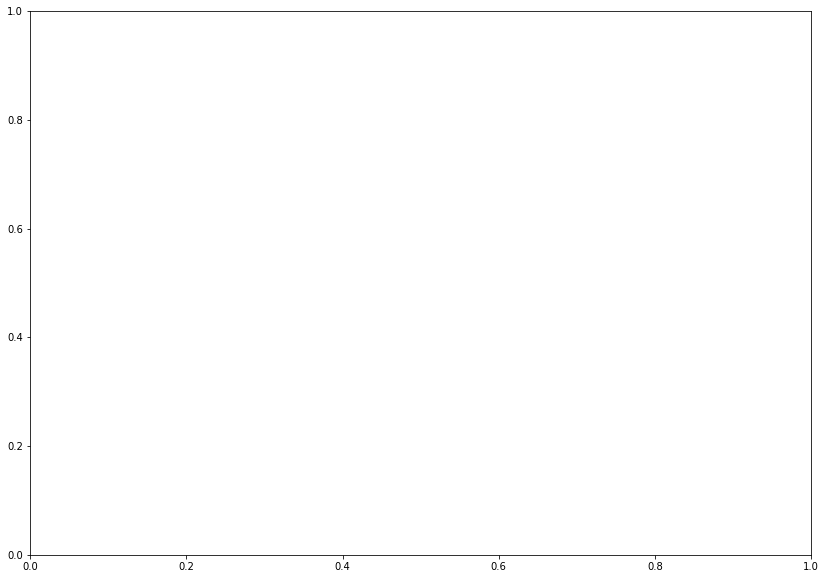

In [48]:
labels = ['Unimodal (Body)', 'Unimodal (Face)', 'Early Fusion', 'Late Fusion']
men_means = cnn_auc
women_means = rnn_auc

x = np.arange(len(labels)) 
width = 0.35 

fig, ax = plt.subplots(figsize=(14, 10))
rects1 = ax.bar(x - width/2, men_means, width, label='CNN + BiLSTM')
rects2 = ax.bar(x + width/2, women_means, width, label='RCNN')

ax.set_title('Baseline AUC (Binary Classification)')
ax.set_xticks(x, labels)
ax.legend()

ax.bar_label(rects1, padding=3)
ax.bar_label(rects2, padding=3)

fig.tight_layout()

plt.show()